In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from io import StringIO
import os
import xlrd
from Bio import SeqIO
from Bio.Seq import Seq
from Bio.SeqRecord import SeqRecord
from itertools import combinations

In [23]:
import warnings

warnings.filterwarnings("ignore")

## DMS datasets

In [24]:
def plot_mutations_per_position(df):
    # Print number of NA
    print(f'Number of NA: {df["variant"].isna().sum()}')
    # Print number of WT
    if "WT" in df["variant"].unique():
        print(f'Number of WT: {df["variant"].value_counts()["WT"]}')
    else:
        print('WT not found in mutation column')
    # Filter out rows with missing or "WT" mutations
    df_filtered = df.dropna(subset=["variant"]).query('variant != "WT"')

    # Initialize an empty dictionary to store the number of mutations per position
    mutations_per_position = {}
    
    # Print the size of the dataset
    print(f'Number of variants: {len(df_filtered)}')

    # Print the number of fitness_binary = 1 values
    print(f'Number of fitness_binary = 1: {len(df_filtered.query("fitness_binary == 1"))}')

    # Iterate over the rows of the DataFrame and increment the count of mutations at each position
    for mutation_str in df_filtered["variant"]:
        # Remove the initial and final characters from the mutation string
        pos = int(mutation_str[1:-1])

        # Increment the count of mutations at this position in the dictionary
        if pos in mutations_per_position:
            mutations_per_position[pos] += 1
        else:
            mutations_per_position[pos] = 1

    # Plot a histogram of the number of mutations per position
    plt.bar(mutations_per_position.keys(), mutations_per_position.values())
    plt.xlabel('Number of mutations')
    plt.ylabel('Number of positions')
    plt.title('Mutations per position')
    plt.show()

In [25]:
def plot_histogram_of_readout(df, column_name, cutoff=None):
    # Plot histogram of readout values for all mutants
    fig, ax = plt.subplots()
    ax.hist(df[column_name].values, bins=100)
    ax.set_xlabel(column_name)
    ax.set_ylabel('Number of mutants')
    ax.set_title(f'{column_name} distribution across mutants')
    
    # Add vertical line to indicate WT value
    # if there is a WT value, add a vertical line
    if "WT" in df["variant"].unique():
        wt_val = df.loc[df["variant"] == 'WT', column_name].values[0]
        ax.axvline(wt_val, color='red', linestyle='--', label='WT')
    # Add vertical line to indicate cutoff value
    if cutoff:
        ax.axvline(cutoff, color='black', linestyle='--', label='cutoff')
    ax.legend()
    plt.show()


In [43]:
def process_dataset(file_path, dataset_name, fitness_column, cutoff_value, sheet_name=None, cutoff_rule='greater_than', AA_shift=None):

    # Check file extension to determine the appropriate reading method
    if file_path.endswith('.xlsx'):
        if isinstance(sheet_name, str):
            # Read the Excel file with the specified sheet name
            dataframe = pd.read_excel(file_path, sheet_name=sheet_name)
        else:
            # Read the Excel file without specifying a sheet name
            dataframe = pd.read_excel(file_path)
    elif file_path.endswith('.csv'):
        # Read the CSV file
        dataframe = pd.read_csv(file_path)
    else:
        raise ValueError("Unsupported file format. Please provide an Excel (.xlsx) or CSV (.csv) file.")

    # Filter out rows with missing values in the fitness column
    filtered_df = dataframe.dropna(subset=[fitness_column])

    # Read the WT sequence based on FASTA file
    fasta_file = f'dataframes_VEP/{dataset_name}_WT.fasta'

    sequences = SeqIO.parse(fasta_file, 'fasta')

    for record in sequences:
        wt_sequence = str(record.seq)
        break
    
    # print(f'WT sequence: {wt_sequence}')

    # Write the filtered dataframe to a FASTA file
    output_file = f'output/{dataset_name}.fasta'
    with open(output_file, 'w') as f:
        for variant in filtered_df['variant']:
            # extract the integer position from the variant string
            # if AA_shift is None, then the position is the integer in the variant string
            if 'WT' in variant:
                f.write(f'>{variant}\n{wt_sequence}\n')             
            else:
                if AA_shift is None:
                    position = int(variant[1:-1]) - 1
                else:
                    position = int(variant[1:-1]) - AA_shift
                # extract the WT amino acid from the variant string
                wt_aa = variant[0]
                # extract the mutated amino acid from the variant string
                mutated_aa = variant[-1]

                # print(f'Position: {position}, WT AA: {wt_aa}, Mutated AA: {mutated_aa}')

                if wt_sequence[position] == wt_aa:
                    sequence = wt_sequence[:position] + mutated_aa + wt_sequence[position+1:]
                    f.write(f'>{variant}\n{sequence}\n')
                else:
                    print(f'Error: WT amino acid at position {position} is not {wt_aa}')

    # Make a fitness column called 'fitness' from fitness_column
    filtered_df['fitness'] = filtered_df[fitness_column]

    # Make a min-max scaled column called 'fitness_scaled' from fitness_column
    filtered_df['fitness_scaled'] = (filtered_df[fitness_column] - filtered_df[fitness_column].min()) / (filtered_df[fitness_column].max() - filtered_df[fitness_column].min())

    # Make a binary column called 'fitness_binary' from fitness_column
    if cutoff_rule == 'greater_than':
        filtered_df.loc[:, 'fitness_binary'] = np.where(filtered_df[fitness_column] > cutoff_value, 1, 0)
    elif cutoff_rule == 'less_than':
        filtered_df.loc[:, 'fitness_binary'] = np.where(filtered_df[fitness_column] < cutoff_value, 1, 0)

    # Calculate the percentage above cutoff
    total_values = len(filtered_df)
    if cutoff_rule == 'greater_than':
        values_above_cutoff = len(filtered_df[filtered_df[fitness_column] > cutoff_value])
    elif cutoff_rule == 'less_than':
        values_above_cutoff = len(filtered_df[filtered_df[fitness_column] < cutoff_value])
    fraction_above_cutoff = (values_above_cutoff / total_values) if total_values > 0 else 0
    
    # Save the filtered dataframe to a CSV file dataset_name_labels.csv in the /output/ folder
    filtered_df.to_csv(f'output/{dataset_name}_labels.csv', index=False)

    # Plot histogram of readout values for all mutants
    plot_histogram_of_readout(filtered_df, 'fitness_scaled')
    plot_histogram_of_readout(filtered_df, 'fitness', cutoff=cutoff_value)

    # plot mutations per position
    plot_mutations_per_position(filtered_df)

    return fraction_above_cutoff

Brenan

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


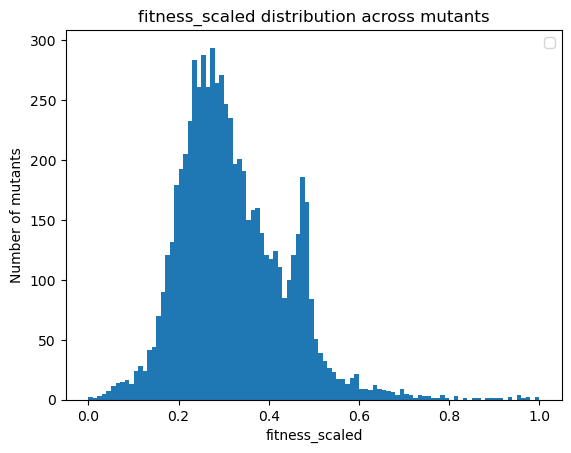

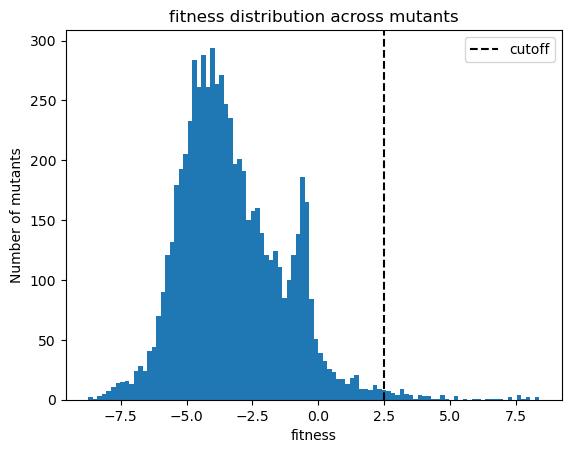

Number of NA: 0
WT not found in mutation column
Number of variants: 6810
Number of fitness_binary = 1: 77


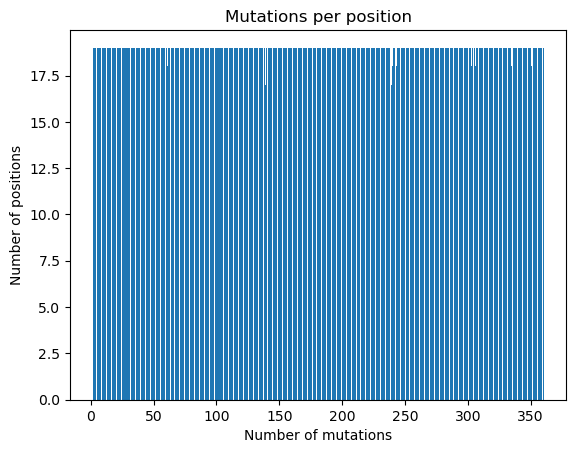

In [44]:
file_path = 'dataframes_VEP/Source.xlsx'  # Provide the path to the Excel file
dataset_name = 'brenan'  # Provide the dataset sheet name
fitness_column = 'DMS_SCH'  # Provide the fitness column name
sheet_name = 'MAPK1'  # Provide the sheet name
cutoff_value = 2.5  # Provide the cutoff value

brenan_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value, sheet_name)

Giacomelli

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


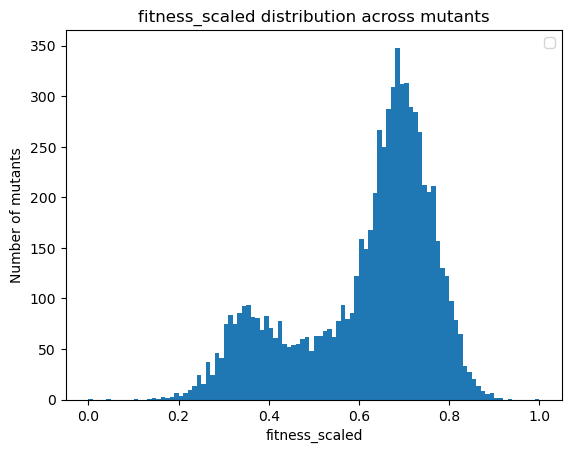

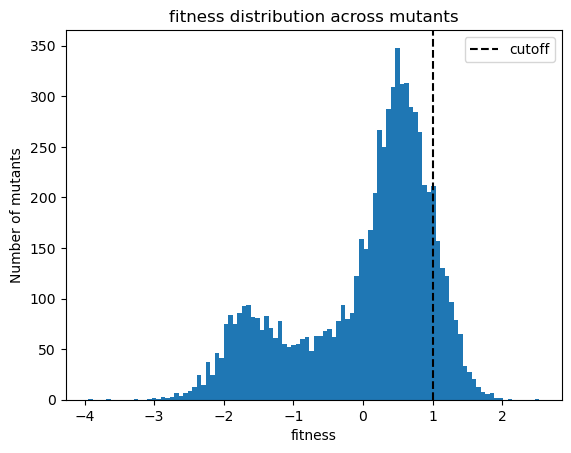

Number of NA: 0
WT not found in mutation column
Number of variants: 7448
Number of fitness_binary = 1: 905


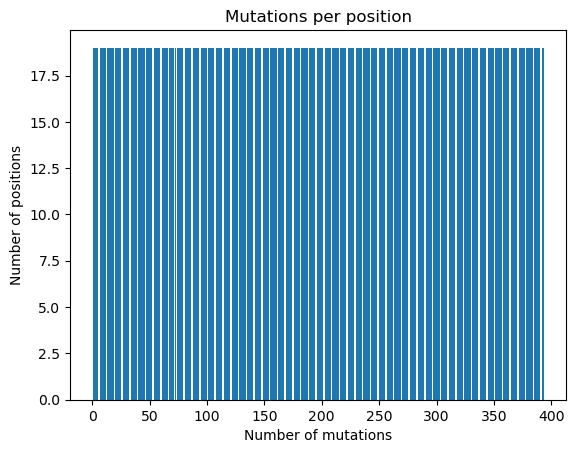

In [45]:
file_path = 'dataframes_VEP/Source.xlsx'  # Provide the path to the Excel file
dataset_name = 'giacomelli'  # Provide the dataset sheet name
fitness_column = 'DMS_null_etoposide'  # Provide the fitness column name
sheet_name = 'P53'  # Provide the sheet name
cutoff_value = 1  # Provide the cutoff value

giacomelli_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value, sheet_name)

Jones

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


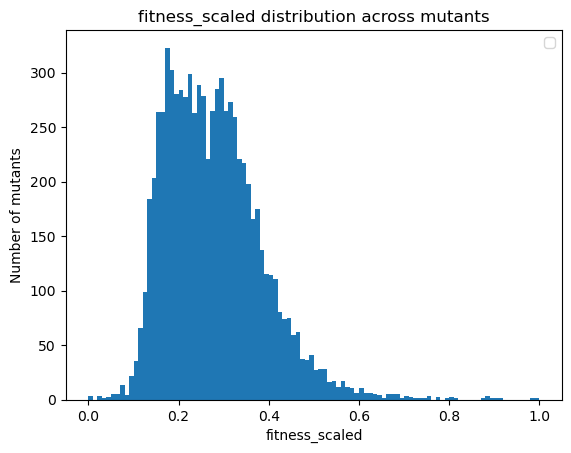

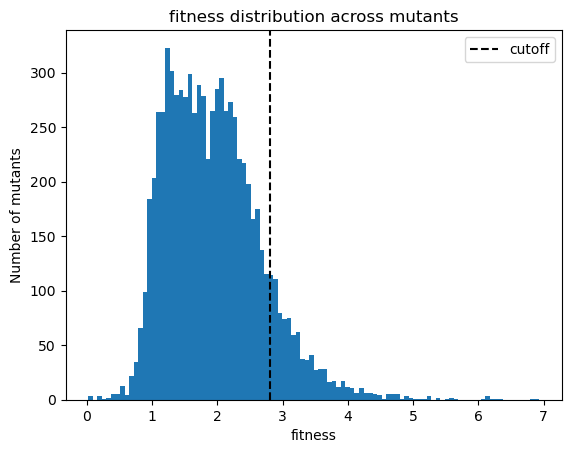

Number of NA: 0
WT not found in mutation column
Number of variants: 7800
Number of fitness_binary = 1: 914


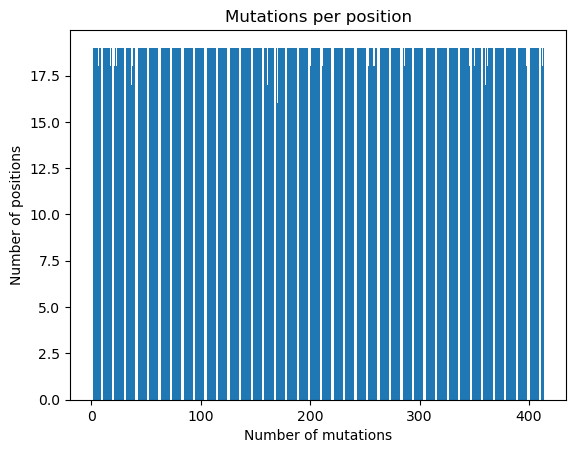

In [46]:
file_path = 'dataframes_VEP/Source.xlsx'  # Provide the path to the Excel file
dataset_name = 'jones'  # Provide the dataset sheet name
fitness_column = 'DMS_0.625'  # Provide the fitness column name
sheet_name = 'ADRB2'  # Provide the sheet name
cutoff_value = 2.8  # Provide the cutoff value

jones_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value, sheet_name)

Kelsic

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


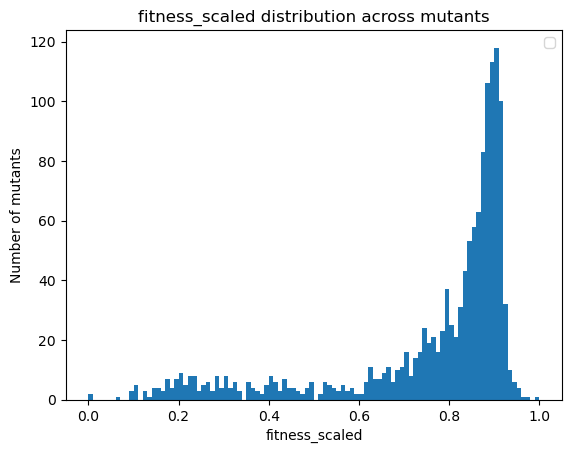

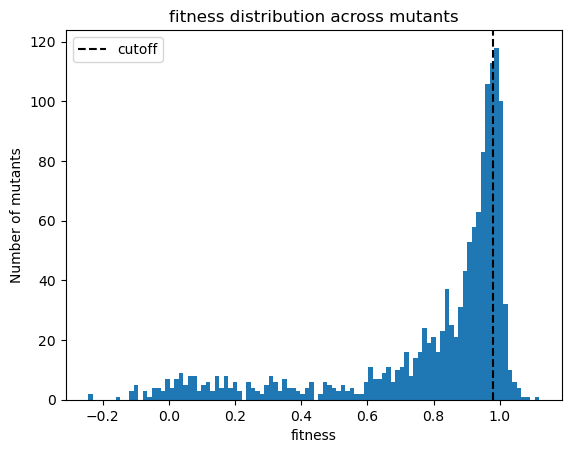

Number of NA: 0
WT not found in mutation column
Number of variants: 1368
Number of fitness_binary = 1: 305


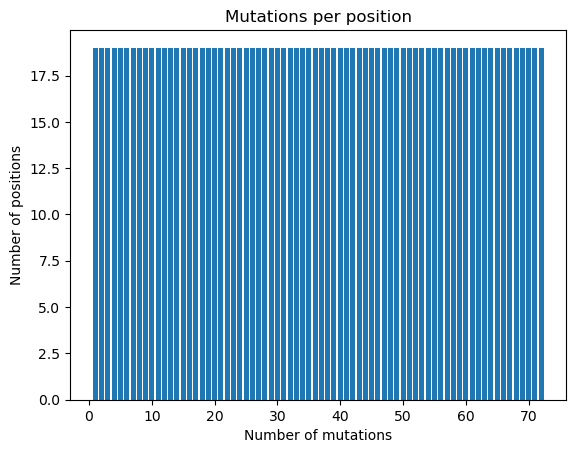

In [66]:
file_path = 'dataframes_VEP/Source.xlsx'  # Provide the path to the Excel file
dataset_name = 'kelsic'  # Provide the dataset sheet name
fitness_column = 'DMS_rich'  # Provide the fitness column name
sheet_name = 'infA'  # Provide the sheet name
cutoff_value = 0.98  # Provide the cutoff value

kelsic_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value, sheet_name)

Stiffler

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


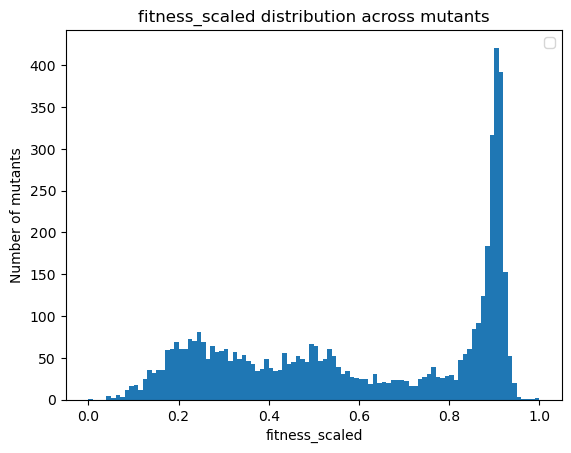

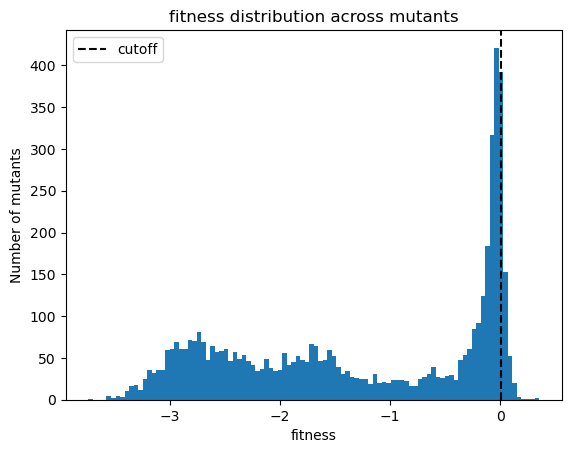

Number of NA: 0
WT not found in mutation column
Number of variants: 4978
Number of fitness_binary = 1: 393


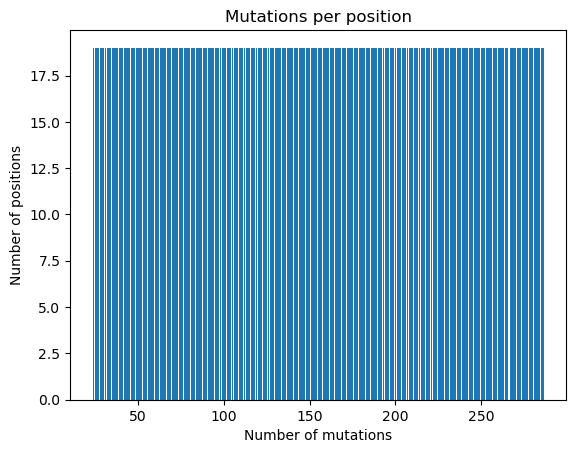

In [48]:
file_path = 'dataframes_VEP/Source.xlsx'  # Provide the path to the Excel file
dataset_name = 'stiffler'  # Provide the dataset sheet name
fitness_column = 'DMS_amp_2500_(b)'  # Provide the fitness column name
sheet_name = 'bla'  # Provide the sheet name
cutoff_value = 0.01  # Provide the cutoff value

stiffler_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value, sheet_name)

Haddox

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


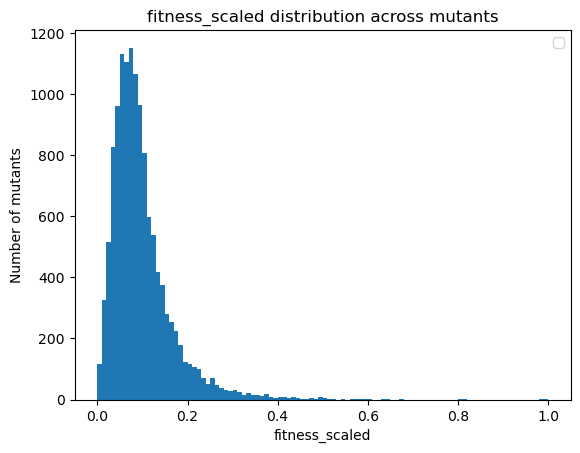

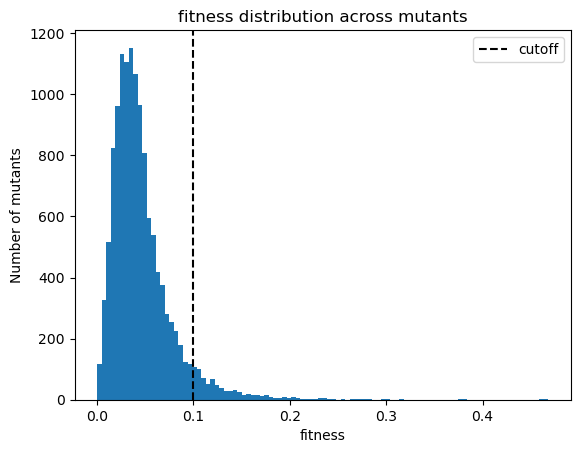

Number of NA: 0
WT not found in mutation column
Number of variants: 12863
Number of fitness_binary = 1: 748


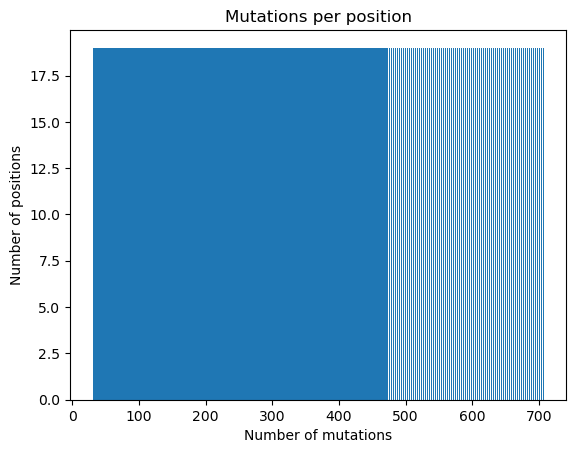

In [49]:
file_path = 'dataframes_VEP/Source.xlsx'  # Provide the path to the Excel file
dataset_name = 'haddox'  # Provide the dataset sheet name
fitness_column = 'DMS'  # Provide the fitness column name
sheet_name = 'env'  # Provide the sheet name
cutoff_value = 0.1  # Provide the cutoff value

haddox_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value, sheet_name)

Doud

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


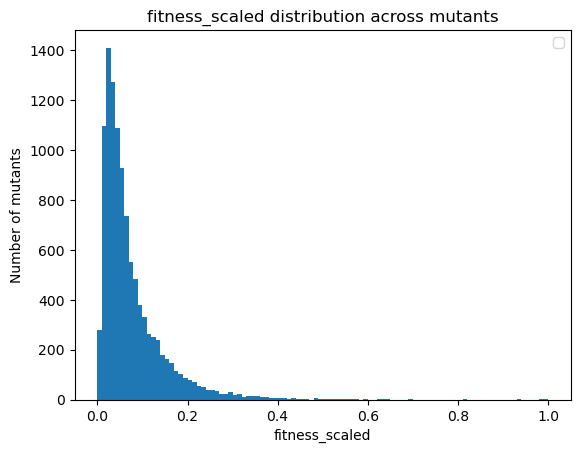

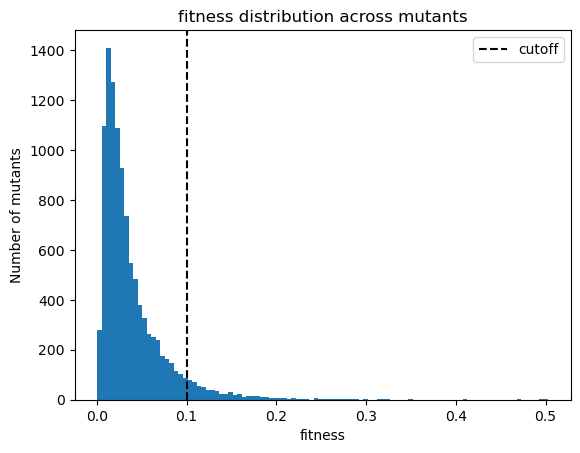

Number of NA: 0
WT not found in mutation column
Number of variants: 10716
Number of fitness_binary = 1: 645


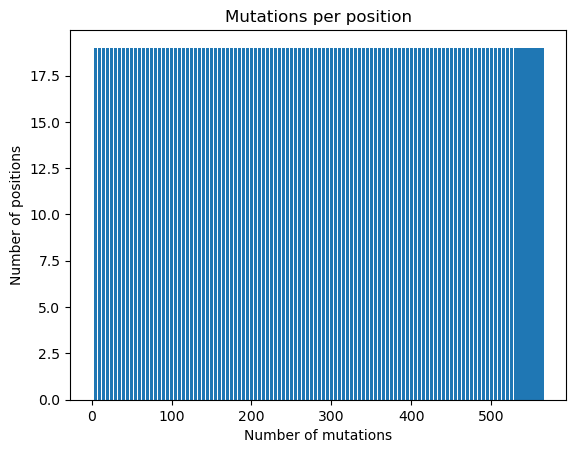

In [50]:
file_path = 'dataframes_VEP/Source.xlsx'  # Provide the path to the Excel file
dataset_name = 'doud'  # Provide the dataset sheet name
fitness_column = 'DMS'  # Provide the fitness column name
sheet_name = 'HA-H1N1'  # Provide the sheet name
cutoff_value = 0.1  # Provide the cutoff value

doud_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value, sheet_name)

Lee

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


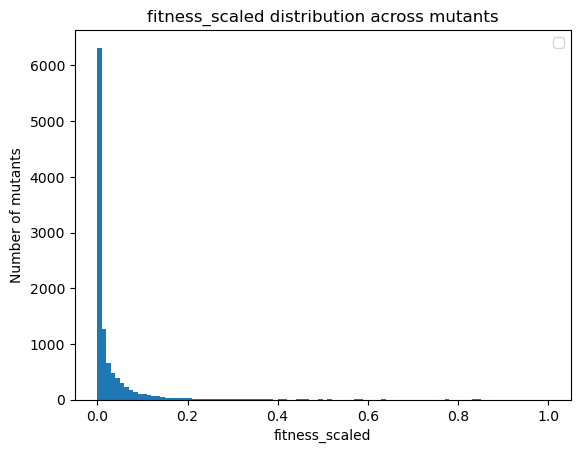

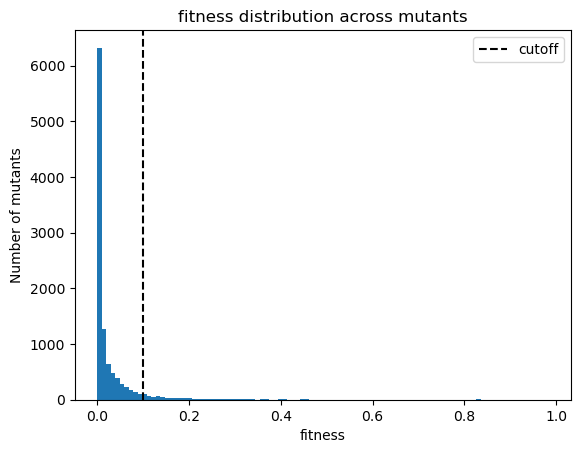

Number of NA: 0
WT not found in mutation column
Number of variants: 10754
Number of fitness_binary = 1: 714


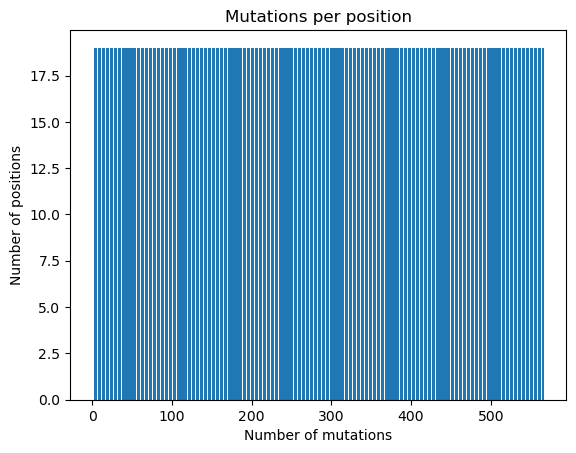

In [51]:
file_path = 'dataframes_VEP/Source.xlsx'  # Provide the path to the Excel file
dataset_name = 'lee'  # Provide the dataset sheet name
fitness_column = 'DMS'  # Provide the fitness column name
sheet_name = 'HA-H3N2'  # Provide the sheet name
cutoff_value = 0.1  # Provide the cutoff value

lee_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value, sheet_name)

Markin

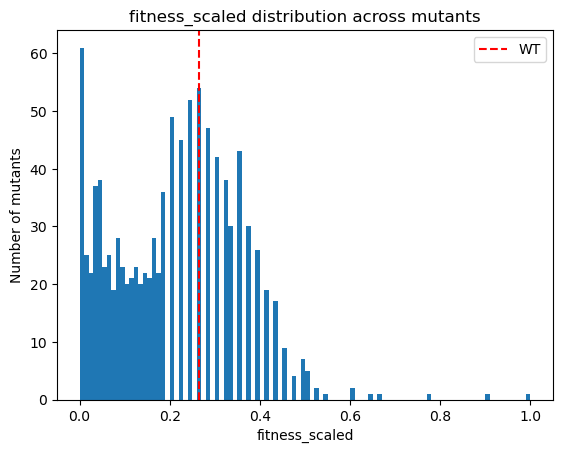

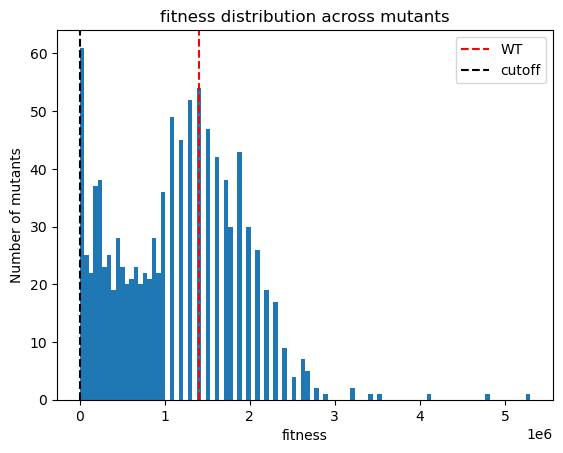

Number of NA: 0
Number of WT: 1
Number of variants: 1040
Number of fitness_binary = 1: 0


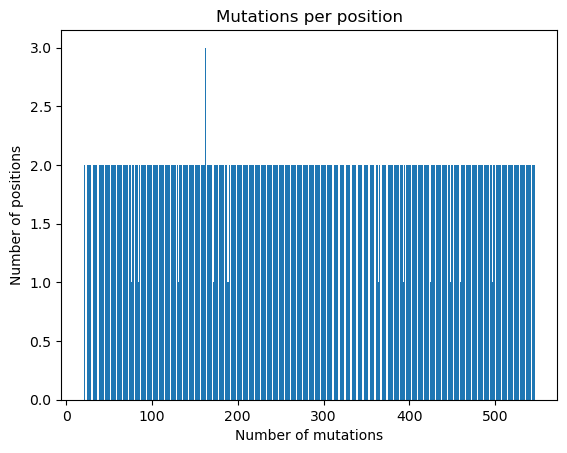

In [52]:
file_path = 'dataframes_VEP/abf8761_markin_data-s1.csv'  # Provide the path to the Excel file
dataset_name = 'markin'  # Provide the dataset sheet name
fitness_column = 'kcatOverKM_cMUP_M-1s-1'  # Provide the fitness column name
cutoff_value = 0.01  # Provide the cutoff value
cutoff_rule = 'less_than'  # Provide the cutoff rule

markin_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value, cutoff_rule=cutoff_rule, AA_shift=20)

In [70]:
# read in markin data and filter for variants with p-value < 0.01
markin = pd.read_csv('dataframes_VEP/abf8761_markin_data-s1.csv')
# get kcatOverKM_cMUP_M-1s-1 variable for WT
markin_WT_fitness = markin[markin['variant'] == 'WT']['kcatOverKM_cMUP_M-1s-1'].values[0]
# read in markin data and filter for variants with p-value < 0.01
markin = pd.read_csv('output/markin_labels.csv')
# fix the fitness_binary column
markin['fitness_binary'] = np.where((markin['kcatOverKM_cMUP_p-value'] < 0.01) & (markin['kcatOverKM_cMUP_M-1s-1'] > markin_WT_fitness), 1, 0)
# save markin dataframe
markin.to_csv('output/markin_labels.csv')
# manually compute fraction
markin_frac=markin['fitness_binary'].mean()
# count the number of fitness_binary values
markin['fitness_binary'].value_counts()

0    1006
1      35
Name: fitness_binary, dtype: int64

Cas12f

In [53]:
# read in DMS_AsCas12f.xlsx
DMS_AsCas12f = pd.read_excel('dataframes_VEP/DMS_AsCas12f.xlsx')

# extract the as the character in variant column, stripping the integers in the column
DMS_AsCas12f['substition'] = DMS_AsCas12f['variant'].str[0]
# extract the position as the integer in variant column, stripping the characters in the column
DMS_AsCas12f['position'] = DMS_AsCas12f['variant'].str[1:].astype(int)
# filter for rows where mean = 1
DMS_AsCas12f_WT = DMS_AsCas12f[DMS_AsCas12f['mean'] == 1]
DMS_AsCas12f_WT = DMS_AsCas12f_WT.rename(columns={'substition': 'WT'})
DMS_AsCas12f_WT = DMS_AsCas12f_WT[['WT', 'position']]

# write a fasta file that is the concatenation of the WT column
with open('dataframes_VEP/cas12f_WT.fasta', 'w') as f:
    f.write(f'>AsCas12f\n{"".join(DMS_AsCas12f_WT["WT"].values)}\n')

# change name of column position to WT
DMS_AsCas12f = DMS_AsCas12f[DMS_AsCas12f['mean'] != 1]
DMS_AsCas12f = DMS_AsCas12f.rename(columns={'variant': 'variant_raw'})

# left join to DMS_AsCas12f with only position and WT column
DMS_AsCas12f = DMS_AsCas12f.merge(DMS_AsCas12f_WT[['position', 'WT']], how='left', on='position')
DMS_AsCas12f

# make a column variant that is the concatenation of WT, position, and substition
DMS_AsCas12f['variant'] = DMS_AsCas12f['WT'] + DMS_AsCas12f['position'].astype(str) + DMS_AsCas12f['substition']
DMS_AsCas12f

# remove column No
DMS_AsCas12f = DMS_AsCas12f.drop(columns=['No'])

# filter out rows where substition is *
DMS_AsCas12f = DMS_AsCas12f[DMS_AsCas12f['substition'] != '*']
# filter out rows where mean is NA
DMS_AsCas12f = DMS_AsCas12f[~DMS_AsCas12f['mean'].isna()]
# change mean to fitness
DMS_AsCas12f = DMS_AsCas12f.rename(columns={'mean': 'fitness'})
# add a row for WT where column variant = WT and mean = 1
WT_row = {
    'variant_raw': 'WT',
    'rep1': 1.0,
    'rep2': 1.0,
    'WT': 'WT',
    'position': np.nan,  # Set 'position' to blank (NaN)
    'substition': np.nan,  # Set 'substition' to blank (NaN)
    'fitness': 1.0,
    'variant': 'WT'
}
DMS_AsCas12f = DMS_AsCas12f.append(WT_row, ignore_index=True)

# write an excel file out of DMS_AsCas12f
DMS_AsCas12f.to_excel('dataframes_VEP/DMS_AsCas12f_clean.xlsx', index=False)


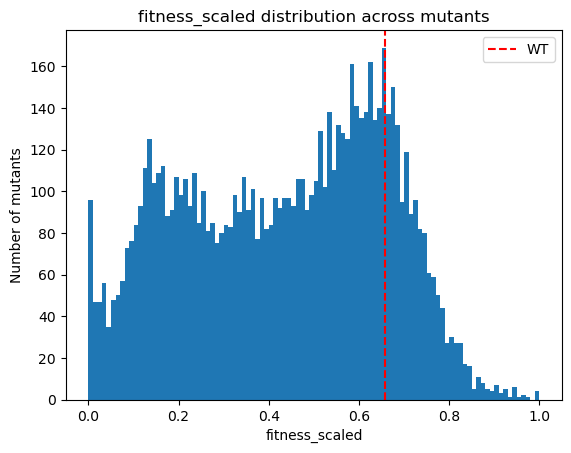

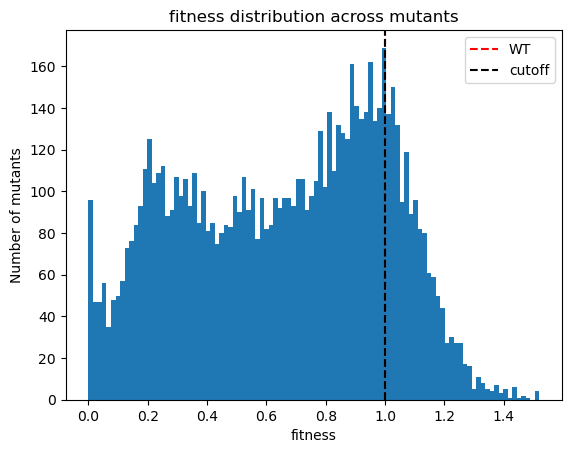

Number of NA: 0
Number of WT: 1
Number of variants: 7941
Number of fitness_binary = 1: 1436


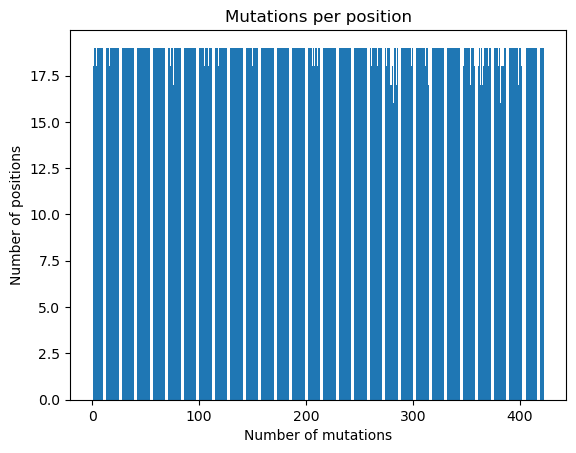

In [55]:
file_path = 'dataframes_VEP/DMS_AsCas12f_clean.xlsx'  # Provide the path to the Excel file
dataset_name = 'cas12f'  # Provide the dataset sheet name
fitness_column = 'fitness'  # Provide the fitness column name
cutoff_value = 1  # Provide the cutoff value

cas12f_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value)

Zika Envelope

In [56]:
# read in jvi.01291-19-sd003.xlsx, sheet mutational effects
jvi = pd.read_excel('dataframes_VEP/jvi.01291-19-sd003.xlsx', sheet_name='mutational effects')

# change column mutation to variant and effect to fitness
jvi = jvi.rename(columns={'mutation': 'variant', 'effect': 'fitness'})

# filter for wildtype = mutant
jvi_WT = jvi[jvi['wildtype'] == jvi['mutant']]

# write a fasta file that is the concatenation of the WT column
with open('dataframes_VEP/zikv_E_WT.fasta', 'w') as f:
    f.write(f'>Zikv_E\n{"".join(jvi_WT["wildtype"].values)}\n')

WT_row = {
    'variant': 'WT',
    'site': np.nan,  # Set 'position' to blank (NaN)
    'wildtype': np.nan,  # Set 'substition' to blank (NaN)
    'mutant': np.nan,
    'fitness': 1.0,
    'log2effect': 0.0
}

jvi = jvi[jvi['wildtype'] != jvi['mutant']]
jvi = jvi.append(WT_row, ignore_index=True)

# write excel file out of jvi
jvi.to_excel('dataframes_VEP/Zikv_E.xlsx', index=False)

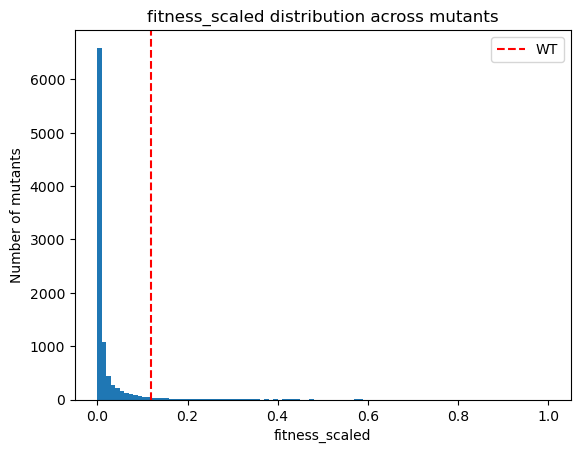

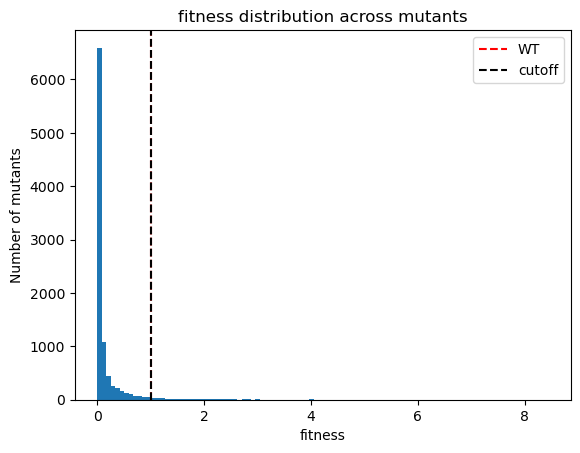

Number of NA: 0
Number of WT: 1
Number of variants: 9576
Number of fitness_binary = 1: 351


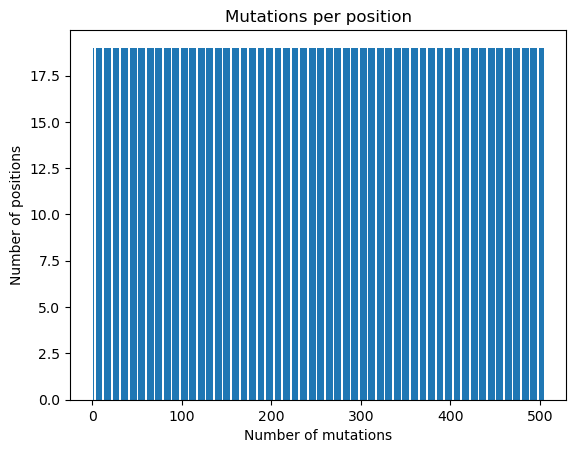

In [57]:
file_path = 'dataframes_VEP/Zikv_E.xlsx'  # Provide the path to the Excel file
dataset_name = 'zikv_E'  # Provide the dataset sheet name
fitness_column = 'fitness'  # Provide the fitness column name
cutoff_value = 1  # Provide the cutoff value

zikv_E_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value)

Sars Cov2 S

In [59]:
# read in all_samples_raw_data--sarscov2.csv
sarscov2 = pd.read_csv('dataframes_VEP/all_samples_raw_data--sarscov2.csv')

# make a column variant that is the concatenation of WT, position, and substition
sarscov2['variant'] = sarscov2['wildtype'] + sarscov2['site'].astype(str) + sarscov2['mutation']

# drop site_total_escape and site_max_escape
sarscov2 = sarscov2.drop(columns=['site_total_escape', 'site_max_escape','condition'])

# rename mut_escape to fitness
sarscov2 = sarscov2.rename(columns={'mut_escape': 'fitness'})

# Assuming your DataFrame is named df
# Group by 'variant' and calculate the mean fitness for each group
sarscov2_averaged = sarscov2.groupby(['variant', 'site', 'wildtype', 'mutation']).agg({
    'fitness': 'mean'
}).reset_index()

sarscov2_averaged = sarscov2_averaged.sort_values(by=['site'])
sarscov2_averaged

# write a csv file out of sarscov2_averaged
sarscov2_averaged.to_csv('dataframes_VEP/sarscov2_averaged.csv', index=False)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


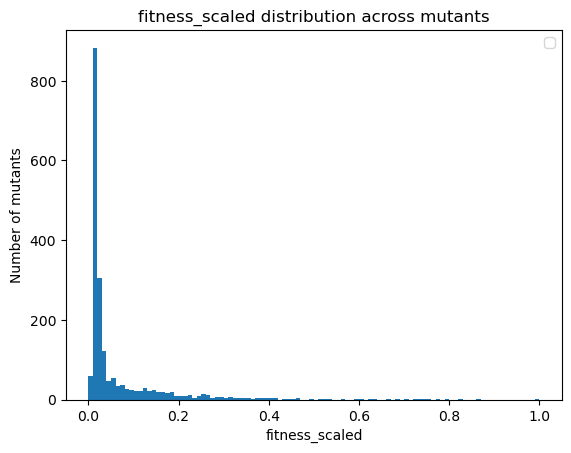

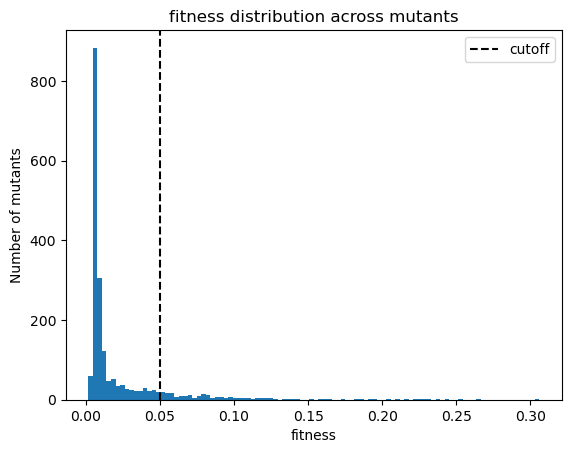

Number of NA: 0
WT not found in mutation column
Number of variants: 1959
Number of fitness_binary = 1: 232


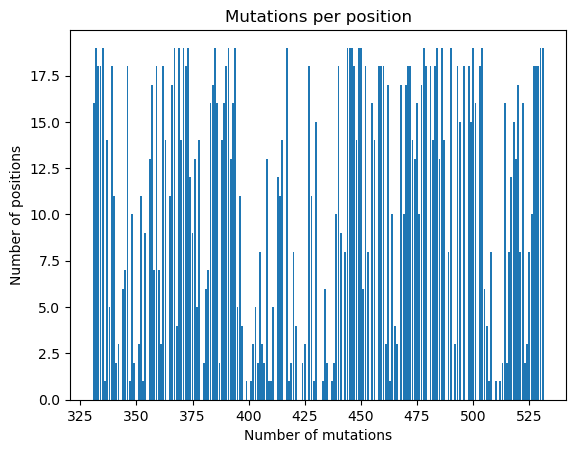

In [60]:
file_path = 'dataframes_VEP/sarscov2_averaged.csv'  # Provide the path to the Excel file
dataset_name = 'cov2_S'  # Provide the dataset sheet name
fitness_column = 'fitness'  # Provide the fitness column name
cutoff_value = 0.05  # Provide the cutoff value

cov2_S_frac=process_dataset(file_path, dataset_name, fitness_column, cutoff_value)

In [74]:
background = pd.DataFrame({'dataset': ['jones', 'stiffler', 'haddox', 'doud', 'lee', 'kelsic', 'brenan', 'giacomelli', 'markin', 'cas12f', 'zikv_E', 'cov2_S'],
              'fitness_binary_percentage_mean': [jones_frac, stiffler_frac, haddox_frac, doud_frac, lee_frac, kelsic_frac, brenan_frac, giacomelli_frac, markin_frac, cas12f_frac, zikv_E_frac, cov2_S_frac],
             })

In [75]:
background.to_csv('background.csv', index=False)

## Wet lab evolution

In [10]:
def generate_single_aa_mutants_fasta(wt_sequence, output_file):
    aa_alphabet = "ACDEFGHIKLMNPQRSTVWY"

    records = []
    
    # Add the wild-type sequence as the first record
    wt_record = SeqRecord(Seq(wt_sequence), id="WT", description="Wild-type sequence")
    records.append(wt_record)
    
    for i, wt_aa in enumerate(wt_sequence):
        for mutant_aa in aa_alphabet:
            if mutant_aa != wt_aa:
                mutant_sequence = wt_sequence[:i] + mutant_aa + wt_sequence[i+1:]
                variant = f'{wt_aa}{i+1}{mutant_aa}'
                record = SeqRecord(Seq(mutant_sequence), id=variant, description="")
                records.append(record)

    with open(output_file, "w") as handle:
        SeqIO.write(records, handle, "fasta")
    
    # Print the number of records
    num_records = len(records)
    print(f"Number of records: {num_records}")

def generate_n_mutant_combinations_fasta(wt_sequence, output_file, mutants, n):
    records = []

    # Add the wild-type sequence as the first record
    wt_record = SeqRecord(Seq(wt_sequence), id="WT", description="Wild-type sequence")
    records.append(wt_record)

    mutant_combinations = list(combinations(mutants['variant'], n))

    for combination in mutant_combinations:
        # rest of the code remains the same
        positions = set()
        valid_combination = True
        mutant_sequence = wt_sequence
        variant = ""

        for mutant in combination:
            wt_aa = mutant[0]
            position = mutant[1:-1]  # Extract position from the middle of the string
            mutant_aa = mutant[-1]            
            
            i = int(position) - 1  # Convert position to 0-based index
            if i in positions:
                # Position is already used in this combination
                print(f"Invalid combination: {combination}")
                valid_combination = False
                break

            positions.add(i)
            mutant_sequence = mutant_sequence[:i] + mutant_aa + mutant_sequence[i + 1:]
            variant += f'{wt_aa}{position}{mutant_aa}_'

        if valid_combination:
            # print the combination
            print(f"Combination: {combination}")
            record = SeqRecord(Seq(mutant_sequence), id=variant.rstrip('_'), description="")
            records.append(record)

    # print number of records
    print(f"Number of combinations: {len(mutant_combinations)}")
    print(f"Number of records: {len(records)}")
    with open(output_file, "w") as handle:
        SeqIO.write(records, handle, "fasta")


In [ ]:
# Example usage
wt_sequence = "MNTINIAKNDFSDIELAAIPFNTLADHYGERLAREQLALEHESYEMGEARFRKMFERQLKAGEVADNAAAKPLITTLLPKMIARINDWFEEVKAKRGKRPTAFQFLQEIKPEAVAYITIKTTLACLTSADNTTVQAVASAIGRAIEDEARFGRIRDLEAKHFKKNVEEQLNKRVGHVYKKAFMQVVEADMLSKGLLGGEAWSSWHKEDSIHVGVRCIEMLIESTGMVSLHRQNAGVVGQDSETIELAPEYAEAIATRAGALAGISPMFQPCVVPPKPWTGITGGGYWANGRRPLALVRTHSKKALMRYEDVYMPEVYKAINIAQNTAWKINKKVLAVANVITKWKHCPVEDIPAIEREELPMKPEDIDMNPEALTAWKRAAAAVYRKDKARKSRRISLEFMLEQANKFANHKAIWFPYNMDWRGRVYAVSMFNPQGNDMTKGLLTLAKGKPIGKEGYYWLKIHGANCAGVDKVPFPERIKFIEENHENIMACAKSPLENTWWAEQDSPFCFLAFCFEYAGVQHHGLSYNCSLPLAFDGSCSGIQHFSAMLRDEVGGRAVNLLPSETVQDIYGIVAKKVNEILQADAINGTDNEVVTVTDENTGEISEKVKLGTKALAGQWLAYGVTRSVTKRSVMTLAYGSKEFGFRQQVLEDTIQPAIDSGKGLMFTQPNQAAGYMAKLIWESVSVTVVAAVEAMNWLKSAAKLLAAEVKDKKTGEILRKRCAVHWVTPDGFPVWQEYKKPIQTRLNLMFLGQFRLQPTINTNKDSEIDAHKQESGIAPNFVHSQDGSHLRKTVVWAHEKYGIESFALIHDSFGTIPADAANLFKAVRETMVDTYESCDVLADFYDQFADQLHESQLDKMPALPAKGNLNLRDILESDFAFA"
print(len(wt_sequence))
output_file = "wet_lab/t7_pol.fasta"
generate_single_aa_mutants_fasta(wt_sequence, output_file)

In [7]:
wt_sequence = "MNTINIAKNDFSDIELAAIPFNTLADHYGERLAREQLALEHESYEMGEARFRKMFERQLKAGEVADNAAAKPLITTLLPKMIARINDWFEEVKAKRGKRPTAFQFLQEIKPEAVAYITIKTTLACLTSADNTTVQAVASAIGRAIEDEARFGRIRDLEAKHFKKNVEEQLNKRVGHVYKKAFMQVVEADMLSKGLLGGEAWSSWHKEDSIHVGVRCIEMLIESTGMVSLHRQNAGVVGQDSETIELAPEYAEAIATRAGALAGISPMFQPCVVPPKPWTGITGGGYWANGRRPLALVRTHSKKALMRYEDVYMPEVYKAINIAQNTAWKINKKVLAVANVITKWKHCPVEDIPAIEREELPMKPEDIDMNPEALTAWKRAAAAVYRKDKARKSRRISLEFMLEQANKFANHKAIWFPYNMDWRGRVYAVSMFNPQGNDMTKGLLTLAKGKPIGKEGYYWLKIHGANCAGVDKVPFPERIKFIEENHENIMACAKSPLENTWWAEQDSPFCFLAFCFEYAGVQHHGLSYNCSLPLAFDGSCSGIQHFSAMLRDEVGGRAVNLLPSETVQDIYGIVAKKVNEILQADAINGTDNEVVTVTDENTGEISEKVKLGTKALAGQWLAYGVTRSVTKRSVMTLAYGSKEFGFRQQVLEDTIQPAIDSGKGLMFTQPNQAAGYMAKLIWESVSVTVVAAVEAMNWLKSAAKLLAAEVKDKKTGEILRKRCAVHWVTPDGFPVWQEYKKPIQTRLNLMFLGQFRLQPTINTNKDSEIDAHKQESGIAPNFVHSQDGSHLRKTVVWAHEKYGIESFALIHDSFGTIPADAANLFKAVRETMVDTYESCDVLADFYDQFADQLHESQLDKMPALPAKGNLNLRDILESDFAFA"

t7_n_mutant = pd.read_excel('n_mutant_dicts/t7_n_mutants.xlsx', header=None)
t7_n_mutant = t7_n_mutant[t7_n_mutant[1] > 1]
t7_n_mutant[['position', 'mutant_aa']] = t7_n_mutant[0].str.extract('(\d+)([A-Z]+)', expand=True)
t7_n_mutant = t7_n_mutant[t7_n_mutant['position'] != '884']
t7_n_mutant['wt_aa'] = t7_n_mutant.apply(lambda row: wt_sequence[int(row['position'])-1], axis=1)
t7_n_mutant['variant'] = t7_n_mutant['wt_aa'] + t7_n_mutant['position'] + t7_n_mutant['mutant_aa']
t7_n_mutant = t7_n_mutant[['variant']]

# print number of rows
print(f"Number of rows: {len(t7_n_mutant)}")
t7_n_mutant

Number of rows: 29


,variant
0,S12N
3,V134T
4,V177L
5,G225E
8,E249C
12,V735S
13,G152N
14,A822S
15,S531T
17,G469Q


In [ ]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/t7_pol_2nd.fasta", t7_n_mutant, n=2)

In [ ]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/t7_pol_3rd.fasta", t7_n_mutant, n=3)

In [ ]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/t7_pol_4th.fasta", t7_n_mutant, n=4)

In [ ]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/t7_pol_5th.fasta", t7_n_mutant, n=5)

In [ ]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/t7_pol_6th.fasta", t7_n_mutant, n=6)

In [ ]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/t7_pol_7th.fasta", t7_n_mutant, n=7)

In [ ]:
# Example usage
wt_sequence = "VKVTVPDKNPPCPCCSTRLNSVLALIDHLKGSHGKRRVCFRCAKCGRENFNHHSTVCHFAKCKGPSEEKPPVGEWICEVCGRDFTTKIGLGQHKRLAHPMVRNQERIDASQPKETSNRGAHKKCWTKEEEELLARLEVQFEGHKNINKLIAEHITTKTNKQISDKRRQMTRKDKGEGGAAGKLGPDTGRGNHSQAKVGNNGLGGNQLPGGPAATKDKAGCHLDKEEGNRIAISQQKKGRLQGRYHKEIKRRLEEGVINTFTKAFKQLLECQEVQPLINKTAQDCFGLLESACHIRTALRGKNKKETQEKPTGGQCLKWMKKRAVKKGNYLRFQRLFHLDRGKLARIILDDIECLSCDIAPSEIYSVFKARWETPGQFAGLGNFKSTGKADNKAFSDLITAKEIKKNVQEMSKGSAPGPDGIAIGDIKGMDPGYSRTAELFNLWLTSGEIPDMVRGCRTVLIPKSTQPERLKDINNWRPITIGSILLRLFSRIITARMTKACPLNPRQRGFIRAAGCSENLKLLQTIIRTAKSEHRPLGVVFVDIAKAFDTVSHQHILHVLQQRGVDPHIIGLVSNMYKDISTFVTTKKDTHTDKIQIRVGVKQGDPLSPLLFNLAMDPLLCKLEESGNGFHRGGHTITAMAFADDLVLLSDSWENMEKNIEILEAFCDLTGLKTQGQKCHGFYIKPTKDSYTVNNCAAWTIYGTPLNMINPGDSEKYLGLQIDPWTGIARSNISSKLDSWLERINQAPLKPLQKLDILKTYTIPRLTYMVDHSEMKAGALEALDLQIRSAVKDWLHLPSCTCDAILYVSTKDGGLGVTKLAGLIPSIQARRLHRIAQSPDETMKAFLDKEQMEKQYAKLWVQAGGKREKIPSIWDALPTPVLLTTSDTLSEWEAPNPKSKYPRPCNWRRKEFEKWTKLQCQGRGIQNFKGDVISNNWIQNYRRIPHRKLLTAVQLRANVYPTREFLGRGRGDDCVKFCRHCEVDLETCGHIISYCPVTKEARIKRHNRICERLIEEAEKKDWVVFKEPHIRDAVKELFKPDLIFVKEDRALVVDVTVRFEATTTSLEEAAIEKVDKYKRLETEVRSLTNAKDVLFMGFPLGARGKWYQGNFKLLDMLGLSESRQVTVAKTLSTDALISSVDIVHMFASKARKMNLVTV"
print(len(wt_sequence))
output_file = "wet_lab/r2.fasta"
generate_single_aa_mutants_fasta(wt_sequence, output_file)

In [ ]:
# Example usage
wt_sequence = "MKRKREDLTLWDAANVHKHKSMWYWWEYIRRKDMVNHEKTDCDVIQLLQSASVKKQKTQSDKFLTSFSVGIRPTKHQKRVLNEMLRVSNYTYNWCLWLVNEKGLKPHQFELQKIVCKTNANDVDPQYRMENDDWFFNNKMTSVKLTSCKNFCTSYKSAKSLKSKLKRPMSVSNIIQGSFCVPKLFIRHLSSKDVSTDNTNMQNRYICMMPDNFEKRSNPKERFLKLAKPITKIPPIDHDVKIVKRADGMFIMNIPCDPKYTRRNASNDTIEKRVCGIDPGGRTFATVYDPIDCCVFQVGIKEDKQYVISKLHNKIDHAHMHLTKAQNKKQQQAARERIVSLKKTHLKLKTFVDDIHLKLSSHLVKEYQYVALGKINVAQLVKTDRPKPLSKRAKRDLLYWQHYRFRQRLTHRTTNTECILDVQNEAYTSKTCGVCGTINKNLEKSETFYCDQCKYNTHRDVNGARNILLKSLRMFPFEKQQQ"
print(len(wt_sequence))
output_file = "wet_lab/fanzor.fasta"
generate_single_aa_mutants_fasta(wt_sequence, output_file)

In [11]:
# Example usage
wt_sequence = "TLNIEDEYRLHETSKEPDVSLGSTWLSDFPQAWAETGGMGLAVRQAPLIIPLKATSTPVSIKQYPMSQEARLGIKPHIQRLLDQGILVPCQSPWNTPLLPVKKPGTNDYRPVQDLREVNKRVEDIHPTVPNPYNLLSGLPPSHQWYTVLDLKDAFFCLRLHPTSQPLFAFEWRDPEMGISGQLTWTRLPQGFKNSPTLFNEALHRDLADFRIQHPDLILLQYVDDLLLAATSELDCQQGTRALLQTLGNLGYRASAKKAQICQKQVKYLGYLLKEGQRWLTEARKETVMGQPTPKTPRQLREFLGKAGFCRLFIPGFAEMAAPLYPLTKPGTLFNWGPDQQKAYQEIKQALLTAPALGLPDLTKPFELFVDEKQGYAKGVLTQKLGPWRRPVAYLSKKLDPVAAGWPPCLRMVAAIAVLTKDAGKLTMGQPLVILAPHAVEALVKQPPDRWLSNARMTHYQALLLDTDRVQFGPVVALNPATLLPLPEEGLQHNCLDILAEAHGTRPDLTDQPLPDADHTWYTDGSSLLQEGQRKAGAAVTTETEVIWAKALPAGTSAQRAELIALTQALKMAEGKKLNVYTDSRYAFATAHIHGEIYRRRGWLTSEGKEIKNKDEILALLKALFLPKRLSIIHCPGHQKGHSAEARGNRMADQAARKAAITETPDTSTLLIENSSP"
print(len(wt_sequence))
output_file = "wet_lab/mlv.fasta"
generate_single_aa_mutants_fasta(wt_sequence, output_file)

677
Number of records: 12864


In [8]:
wt_sequence = "TLNIEDEYRLHETSKEPDVSLGSTWLSDFPQAWAETGGMGLAVRQAPLIIPLKATSTPVSIKQYPMSQEARLGIKPHIQRLLDQGILVPCQSPWNTPLLPVKKPGTNDYRPVQDLREVNKRVEDIHPTVPNPYNLLSGLPPSHQWYTVLDLKDAFFCLRLHPTSQPLFAFEWRDPEMGISGQLTWTRLPQGFKNSPTLFNEALHRDLADFRIQHPDLILLQYVDDLLLAATSELDCQQGTRALLQTLGNLGYRASAKKAQICQKQVKYLGYLLKEGQRWLTEARKETVMGQPTPKTPRQLREFLGKAGFCRLFIPGFAEMAAPLYPLTKPGTLFNWGPDQQKAYQEIKQALLTAPALGLPDLTKPFELFVDEKQGYAKGVLTQKLGPWRRPVAYLSKKLDPVAAGWPPCLRMVAAIAVLTKDAGKLTMGQPLVILAPHAVEALVKQPPDRWLSNARMTHYQALLLDTDRVQFGPVVALNPATLLPLPEEGLQHNCLDILAEAHGTRPDLTDQPLPDADHTWYTDGSSLLQEGQRKAGAAVTTETEVIWAKALPAGTSAQRAELIALTQALKMAEGKKLNVYTDSRYAFATAHIHGEIYRRRGWLTSEGKEIKNKDEILALLKALFLPKRLSIIHCPGHQKGHSAEARGNRMADQAARKAAITETPDTSTLLIENSSP"

mlv_n_mutant = pd.read_excel('n_mutant_dicts/mlv_n_mutants.xlsx', header=None)
mlv_n_mutant = mlv_n_mutant[mlv_n_mutant[1] > 1]
mlv_n_mutant[['position', 'mutant_aa']] = mlv_n_mutant[0].str.extract('(\d+)([A-Z]+)', expand=True)
mlv_n_mutant['wt_aa'] = mlv_n_mutant.apply(lambda row: wt_sequence[int(row['position'])-1], axis=1)
mlv_n_mutant['variant'] = mlv_n_mutant['wt_aa'] + mlv_n_mutant['position'] + mlv_n_mutant['mutant_aa']
mlv_n_mutant = mlv_n_mutant[['variant']]

# print number of rows
print(f"Number of rows: {len(mlv_n_mutant)}")
mlv_n_mutant

Number of rows: 10


,variant
0,L419M
1,S675T
2,L671R
3,L491M
4,L333I
5,L514M
6,L670K
7,P485V
8,Q492R
9,S668G


In [11]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_2nd.fasta", mlv_n_mutant, n=2)

Combination: ('L419M', 'S675T')
Combination: ('L419M', 'L671R')
Combination: ('L419M', 'L491M')
Combination: ('L419M', 'L333I')
Combination: ('L419M', 'L514M')
Combination: ('L419M', 'L670K')
Combination: ('L419M', 'P485V')
Combination: ('L419M', 'Q492R')
Combination: ('L419M', 'S668G')
Combination: ('S675T', 'L671R')
Combination: ('S675T', 'L491M')
Combination: ('S675T', 'L333I')
Combination: ('S675T', 'L514M')
Combination: ('S675T', 'L670K')
Combination: ('S675T', 'P485V')
Combination: ('S675T', 'Q492R')
Combination: ('S675T', 'S668G')
Combination: ('L671R', 'L491M')
Combination: ('L671R', 'L333I')
Combination: ('L671R', 'L514M')
Combination: ('L671R', 'L670K')
Combination: ('L671R', 'P485V')
Combination: ('L671R', 'Q492R')
Combination: ('L671R', 'S668G')
Combination: ('L491M', 'L333I')
Combination: ('L491M', 'L514M')
Combination: ('L491M', 'L670K')
Combination: ('L491M', 'P485V')
Combination: ('L491M', 'Q492R')
Combination: ('L491M', 'S668G')
Combination: ('L333I', 'L514M')
Combinat

In [12]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_3rd.fasta", mlv_n_mutant, n=3)

Combination: ('L419M', 'S675T', 'L671R')
Combination: ('L419M', 'S675T', 'L491M')
Combination: ('L419M', 'S675T', 'L333I')
Combination: ('L419M', 'S675T', 'L514M')
Combination: ('L419M', 'S675T', 'L670K')
Combination: ('L419M', 'S675T', 'P485V')
Combination: ('L419M', 'S675T', 'Q492R')
Combination: ('L419M', 'S675T', 'S668G')
Combination: ('L419M', 'L671R', 'L491M')
Combination: ('L419M', 'L671R', 'L333I')
Combination: ('L419M', 'L671R', 'L514M')
Combination: ('L419M', 'L671R', 'L670K')
Combination: ('L419M', 'L671R', 'P485V')
Combination: ('L419M', 'L671R', 'Q492R')
Combination: ('L419M', 'L671R', 'S668G')
Combination: ('L419M', 'L491M', 'L333I')
Combination: ('L419M', 'L491M', 'L514M')
Combination: ('L419M', 'L491M', 'L670K')
Combination: ('L419M', 'L491M', 'P485V')
Combination: ('L419M', 'L491M', 'Q492R')
Combination: ('L419M', 'L491M', 'S668G')
Combination: ('L419M', 'L333I', 'L514M')
Combination: ('L419M', 'L333I', 'L670K')
Combination: ('L419M', 'L333I', 'P485V')
Combination: ('L

In [13]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_4th.fasta", mlv_n_mutant, n=4)

Combination: ('L419M', 'S675T', 'L671R', 'L491M')
Combination: ('L419M', 'S675T', 'L671R', 'L333I')
Combination: ('L419M', 'S675T', 'L671R', 'L514M')
Combination: ('L419M', 'S675T', 'L671R', 'L670K')
Combination: ('L419M', 'S675T', 'L671R', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'S668G')
Combination: ('L419M', 'S675T', 'L491M', 'L333I')
Combination: ('L419M', 'S675T', 'L491M', 'L514M')
Combination: ('L419M', 'S675T', 'L491M', 'L670K')
Combination: ('L419M', 'S675T', 'L491M', 'P485V')
Combination: ('L419M', 'S675T', 'L491M', 'Q492R')
Combination: ('L419M', 'S675T', 'L491M', 'S668G')
Combination: ('L419M', 'S675T', 'L333I', 'L514M')
Combination: ('L419M', 'S675T', 'L333I', 'L670K')
Combination: ('L419M', 'S675T', 'L333I', 'P485V')
Combination: ('L419M', 'S675T', 'L333I', 'Q492R')
Combination: ('L419M', 'S675T', 'L333I', 'S668G')
Combination: ('L419M', 'S675T', 'L514M', 'L670K')
Combination: ('L419M', 'S675T', 'L514M', 'P485V')


In [14]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_5th.fasta", mlv_n_mutant, n=5)

Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L514M')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L670K')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L333I', 'L514M')
Combination: ('L419M', 'S675T', 'L671R', 'L333I', 'L670K')
Combination: ('L419M', 'S675T', 'L671R', 'L333I', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'L333I', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L333I', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L514M', 'L670K')
Combination: ('L419M', 'S675T', 'L671R', 'L514M', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'L514M', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L514M', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L670K', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'L670K', 'Q492R

In [15]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_6th.fasta", mlv_n_mutant, n=6)

Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'L514M')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'L670K')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L514M', 'L670K')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L514M', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L514M', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L514M', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L670K', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L670K', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L670K', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'P485V', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'P485V', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L491M'

In [16]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_7th.fasta", mlv_n_mutant, n=7)

Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'L514M', 'L670K')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'L514M', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'L514M', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'L514M', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'L670K', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'L670K', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'L670K', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'P485V', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'P485V', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L333I', 'Q492R', 'S668G')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L514M', 'L670K', 'P485V')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L514M', 'L670K', 'Q492R')
Combination: ('L419M', 'S675T', 'L671R', 'L491M', 'L514M', 'L670K', 'S668G')

In [12]:
wt_sequence = "TLNIEDEYRLHETSKEPDVSLGSTWLSDFPQAWAETGGMGLAVRQAPLIIPLKATSTPVSIKQYPMSQEARLGIKPHIQRLLDQGILVPCQSPWNTPLLPVKKPGTNDYRPVQDLREVNKRVEDIHPTVPNPYNLLSGLPPSHQWYTVLDLKDAFFCLRLHPTSQPLFAFEWRDPEMGISGQLTWTRLPQGFKNSPTLFNEALHRDLADFRIQHPDLILLQYVDDLLLAATSELDCQQGTRALLQTLGNLGYRASAKKAQICQKQVKYLGYLLKEGQRWLTEARKETVMGQPTPKTPRQLREFLGKAGFCRLFIPGFAEMAAPLYPLTKPGTLFNWGPDQQKAYQEIKQALLTAPALGLPDLTKPFELFVDEKQGYAKGVLTQKLGPWRRPVAYLSKKLDPVAAGWPPCLRMVAAIAVLTKDAGKLTMGQPLVILAPHAVEALVKQPPDRWLSNARMTHYQALLLDTDRVQFGPVVALNPATLLPLPEEGLQHNCLDILAEAHGTRPDLTDQPLPDADHTWYTDGSSLLQEGQRKAGAAVTTETEVIWAKALPAGTSAQRAELIALTQALKMAEGKKLNVYTDSRYAFATAHIHGEIYRRRGWLTSEGKEIKNKDEILALLKALFLPKRLSIIHCPGHQKGHSAEARGNRMADQAARKAAITETPDTSTLLIENSSP"

mlv_n_mutant_2 = pd.read_excel('n_mutant_dicts/mlv_n_mutants_2.xlsx', header=None)
mlv_n_mutant_2 = mlv_n_mutant_2[mlv_n_mutant_2[1] > 1]
mlv_n_mutant_2[['position', 'mutant_aa']] = mlv_n_mutant_2[0].str.extract('(\d+)([A-Z]+)', expand=True)
mlv_n_mutant_2['wt_aa'] = mlv_n_mutant_2.apply(lambda row: wt_sequence[int(row['position'])-1], axis=1)
mlv_n_mutant_2['variant'] = mlv_n_mutant_2['wt_aa'] + mlv_n_mutant_2['position'] + mlv_n_mutant_2['mutant_aa']
mlv_n_mutant_2 = mlv_n_mutant_2[['variant']]

# print number of rows
print(f"Number of rows: {len(mlv_n_mutant_2)}")
mlv_n_mutant_2

Number of rows: 32


,variant
15,L419M
20,L671T
21,L670I
22,S675T
23,L671I
27,L491M
29,L333I
31,L514M
32,L670K
33,L670N


In [13]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_2nd_2.fasta", mlv_n_mutant_2, n=2)

Combination: ('L419M', 'L671T')
Combination: ('L419M', 'L670I')
Combination: ('L419M', 'S675T')
Combination: ('L419M', 'L671I')
Combination: ('L419M', 'L491M')
Combination: ('L419M', 'L333I')
Combination: ('L419M', 'L514M')
Combination: ('L419M', 'L670K')
Combination: ('L419M', 'L670N')
Combination: ('L419M', 'L671R')
Combination: ('L419M', 'L333R')
Combination: ('L419M', 'L670M')
Combination: ('L419M', 'L670R')
Combination: ('L419M', 'P485V')
Combination: ('L419M', 'Q492R')
Combination: ('L419M', 'L670C')
Combination: ('L419M', 'M39E')
Combination: ('L419M', 'S668G')
Combination: ('L419M', 'L671M')
Combination: ('L419M', 'L670D')
Combination: ('L419M', 'D666R')
Combination: ('L419M', 'V580S')
Combination: ('L419M', 'A659E')
Combination: ('L419M', 'D653I')
Combination: ('L419M', 'T669W')
Combination: ('L419M', 'A659I')
Combination: ('L419M', 'D666G')
Combination: ('L419M', 'N649A')
Combination: ('L419M', 'L670G')
Combination: ('L419M', 'L670W')
Combination: ('L419M', 'L671K')
Combinati

In [14]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_3rd_2.fasta", mlv_n_mutant_2, n=3)

Combination: ('L419M', 'L671T', 'L670I')
Combination: ('L419M', 'L671T', 'S675T')
Invalid combination: ('L419M', 'L671T', 'L671I')
Combination: ('L419M', 'L671T', 'L491M')
Combination: ('L419M', 'L671T', 'L333I')
Combination: ('L419M', 'L671T', 'L514M')
Combination: ('L419M', 'L671T', 'L670K')
Combination: ('L419M', 'L671T', 'L670N')
Invalid combination: ('L419M', 'L671T', 'L671R')
Combination: ('L419M', 'L671T', 'L333R')
Combination: ('L419M', 'L671T', 'L670M')
Combination: ('L419M', 'L671T', 'L670R')
Combination: ('L419M', 'L671T', 'P485V')
Combination: ('L419M', 'L671T', 'Q492R')
Combination: ('L419M', 'L671T', 'L670C')
Combination: ('L419M', 'L671T', 'M39E')
Combination: ('L419M', 'L671T', 'S668G')
Invalid combination: ('L419M', 'L671T', 'L671M')
Combination: ('L419M', 'L671T', 'L670D')
Combination: ('L419M', 'L671T', 'D666R')
Combination: ('L419M', 'L671T', 'V580S')
Combination: ('L419M', 'L671T', 'A659E')
Combination: ('L419M', 'L671T', 'D653I')
Combination: ('L419M', 'L671T', 'T

In [15]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_4th_2.fasta", mlv_n_mutant_2, n=4)

Combination: ('L419M', 'L671T', 'L670I', 'S675T')
Invalid combination: ('L419M', 'L671T', 'L670I', 'L671I')
Combination: ('L419M', 'L671T', 'L670I', 'L491M')
Combination: ('L419M', 'L671T', 'L670I', 'L333I')
Combination: ('L419M', 'L671T', 'L670I', 'L514M')
Invalid combination: ('L419M', 'L671T', 'L670I', 'L670K')
Invalid combination: ('L419M', 'L671T', 'L670I', 'L670N')
Invalid combination: ('L419M', 'L671T', 'L670I', 'L671R')
Combination: ('L419M', 'L671T', 'L670I', 'L333R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'L670M')
Invalid combination: ('L419M', 'L671T', 'L670I', 'L670R')
Combination: ('L419M', 'L671T', 'L670I', 'P485V')
Combination: ('L419M', 'L671T', 'L670I', 'Q492R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'L670C')
Combination: ('L419M', 'L671T', 'L670I', 'M39E')
Combination: ('L419M', 'L671T', 'L670I', 'S668G')
Invalid combination: ('L419M', 'L671T', 'L670I', 'L671M')
Invalid combination: ('L419M', 'L671T', 'L670I', 'L670D')
Combination: ('L419M', 'L671T

In [16]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_5th_2.fasta", mlv_n_mutant_2, n=5)

Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I')
Combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L491M')
Combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L333I')
Combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L514M')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L670K')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L670N')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671R')
Combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L333R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L670M')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L670R')
Combination: ('L419M', 'L671T', 'L670I', 'S675T', 'P485V')
Combination: ('L419M', 'L671T', 'L670I', 'S675T', 'Q492R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L670C')
Combination: ('L419M', 'L671T', 'L670I', 'S675T', 'M39E')
Combination: ('L419M', 'L671T', 'L670I', 'S675T', 'S668G')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [17]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_6th_2.fasta", mlv_n_mutant_2, n=6)

Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L333I')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L514M')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L670K')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L670N')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L671R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L333R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L670M')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L670R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'P485V')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'Q492R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L670C')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'M39E')
Invalid combi

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Invalid combination: ('L671T', 'S675T', 'L514M', 'L333R', 'N649A', 'L671K')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L333R', 'L670G', 'L670W')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L333R', 'L670G', 'L671K')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L333R', 'L670W', 'L671K')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L670M', 'L670R', 'P485V')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L670M', 'L670R', 'Q492R')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L670M', 'L670R', 'L670C')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L670M', 'L670R', 'M39E')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L670M', 'L670R', 'S668G')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L670M', 'L670R', 'L671M')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L670M', 'L670R', 'L670D')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L670M', 'L670R', 'D666R')
Invalid combination: ('L671T', 'S675T', 'L514M', 'L670M', 'L670R', 'V580S')
Invalid combi

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Combination: ('L491M', 'L333R', 'L670R', 'M39E', 'V580S', 'D666G')
Combination: ('L491M', 'L333R', 'L670R', 'M39E', 'V580S', 'N649A')
Invalid combination: ('L491M', 'L333R', 'L670R', 'M39E', 'V580S', 'L670G')
Invalid combination: ('L491M', 'L333R', 'L670R', 'M39E', 'V580S', 'L670W')
Combination: ('L491M', 'L333R', 'L670R', 'M39E', 'V580S', 'L671K')
Combination: ('L491M', 'L333R', 'L670R', 'M39E', 'A659E', 'D653I')
Combination: ('L491M', 'L333R', 'L670R', 'M39E', 'A659E', 'T669W')
Invalid combination: ('L491M', 'L333R', 'L670R', 'M39E', 'A659E', 'A659I')
Combination: ('L491M', 'L333R', 'L670R', 'M39E', 'A659E', 'D666G')
Combination: ('L491M', 'L333R', 'L670R', 'M39E', 'A659E', 'N649A')
Invalid combination: ('L491M', 'L333R', 'L670R', 'M39E', 'A659E', 'L670G')
Invalid combination: ('L491M', 'L333R', 'L670R', 'M39E', 'A659E', 'L670W')
Combination: ('L491M', 'L333R', 'L670R', 'M39E', 'A659E', 'L671K')
Combination: ('L491M', 'L333R', 'L670R', 'M39E', 'D653I', 'T669W')
Combination: ('L491M',

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [18]:
generate_n_mutant_combinations_fasta(wt_sequence, "wet_lab/mlv_7th_2.fasta", mlv_n_mutant_2, n=7)

Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'L333I')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'L514M')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'L670K')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'L670N')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'L671R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'L333R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'L670M')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'L670R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'P485V')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'Q492R')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I', 'L491M', 'L670C')
Invalid combination: ('L419M', 'L671T', 'L670I', 'S675T', 'L671I'

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'T669W', 'D666G')
Combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'T669W', 'N649A')
Invalid combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'T669W', 'L670G')
Invalid combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'T669W', 'L670W')
Combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'T669W', 'L671K')
Combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'A659I', 'D666G')
Combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'A659I', 'N649A')
Invalid combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'A659I', 'L670G')
Invalid combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'A659I', 'L670W')
Combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'A659I', 'L671K')
Combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'D666G', 'N649A')
Invalid combination: ('L419M', 'S675T', 'L514M', 'L670K', 'S668G', 'D666G', 'L670G')
Invalid combination: ('L419M', 'S675

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'A659I', 'N649A')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'A659I', 'L670G')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'A659I', 'L670W')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'A659I', 'L671K')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'D666G', 'N649A')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'D666G', 'L670G')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'D666G', 'L670W')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'D666G', 'L671K')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'N649A', 'L670G')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'N649A', 'L670W')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E', 'N649A', 'L671K')
Invalid combination: ('L419M', 'L671R', 'L671M', 'V580S', 'A659E'

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'A659E', 'D666G')
Combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'A659E', 'N649A')
Invalid combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'A659E', 'L670G')
Invalid combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'A659E', 'L670W')
Invalid combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'A659E', 'L671K')
Combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'D653I', 'T669W')
Combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'D653I', 'A659I')
Combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'D653I', 'D666G')
Combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'D653I', 'N649A')
Invalid combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'D653I', 'L670G')
Invalid combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'D653I', 'L670W')
Invalid combination: ('S675T', 'L671I', 'L491M', 'L333I', 'L670C', 'D653I', 'L671K')
Combination: ('S675T', 'L671

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Invalid combination: ('S675T', 'L671R', 'P485V', 'D666R', 'D666G', 'L670G', 'L670W')
Invalid combination: ('S675T', 'L671R', 'P485V', 'D666R', 'D666G', 'L670G', 'L671K')
Invalid combination: ('S675T', 'L671R', 'P485V', 'D666R', 'D666G', 'L670W', 'L671K')
Invalid combination: ('S675T', 'L671R', 'P485V', 'D666R', 'N649A', 'L670G', 'L670W')
Invalid combination: ('S675T', 'L671R', 'P485V', 'D666R', 'N649A', 'L670G', 'L671K')
Invalid combination: ('S675T', 'L671R', 'P485V', 'D666R', 'N649A', 'L670W', 'L671K')
Invalid combination: ('S675T', 'L671R', 'P485V', 'D666R', 'L670G', 'L670W', 'L671K')
Combination: ('S675T', 'L671R', 'P485V', 'V580S', 'A659E', 'D653I', 'T669W')
Invalid combination: ('S675T', 'L671R', 'P485V', 'V580S', 'A659E', 'D653I', 'A659I')
Combination: ('S675T', 'L671R', 'P485V', 'V580S', 'A659E', 'D653I', 'D666G')
Combination: ('S675T', 'L671R', 'P485V', 'V580S', 'A659E', 'D653I', 'N649A')
Combination: ('S675T', 'L671R', 'P485V', 'V580S', 'A659E', 'D653I', 'L670G')
Combination:

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Invalid combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'A659E', 'A659I')
Invalid combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'A659E', 'D666G')
Combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'A659E', 'N649A')
Invalid combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'A659E', 'L670G')
Invalid combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'A659E', 'L670W')
Invalid combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'A659E', 'L671K')
Combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'D653I', 'T669W')
Combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'D653I', 'A659I')
Invalid combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'D653I', 'D666G')
Combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'D653I', 'N649A')
Invalid combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'D653I', 'L670G')
Invalid combination: ('L671I', 'Q492R', 'L670C', 'D666R', 'V580S', 'D653I', 'L670W')
Invalid comb

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'T669W', 'L670G', 'L671K')
Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'T669W', 'L670W', 'L671K')
Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'A659I', 'D666G', 'N649A')
Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'A659I', 'D666G', 'L670G')
Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'A659I', 'D666G', 'L670W')
Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'A659I', 'D666G', 'L671K')
Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'A659I', 'N649A', 'L670G')
Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'A659I', 'N649A', 'L670W')
Combination: ('L333I', 'L670N', 'P485V', 'D666R', 'A659I', 'N649A', 'L671K')
Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'A659I', 'L670G', 'L670W')
Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'A659I', 'L670G', 'L671K')
Invalid combination: ('L333I', 'L670N', 'P485V', 'D666R', 'A659I', 'L670W

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'D666R', 'A659I')
Invalid combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'D666R', 'D666G')
Combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'D666R', 'N649A')
Invalid combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'D666R', 'L670G')
Invalid combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'D666R', 'L670W')
Invalid combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'D666R', 'L671K')
Combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'V580S', 'A659E')
Combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'V580S', 'D653I')
Combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'V580S', 'T669W')
Combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'V580S', 'A659I')
Combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'V580S', 'D666G')
Combination: ('L671R', 'L333R', 'L670R', 'P485V', 'S668G', 'V580S', 'N649A')
Invalid combination: ('L671R', 'L333R', 'L67

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [ ]:
# Example usage
wt_sequence = "MRALVVIRLSRVTDATTSPERQLESCQQLCAQRGWDVVGVAEDLDVSGAVDPFDRKRRPNLARWLAFEEQPFDVIVAYRVDRLTRSIRHLQQLVHWAEDHKKLVVSATEAHFDTTTPFAAVVIALMGTVAQMELEAIKERNRSAAHFNIRAGKYRGSLPPWGYLPTRVDGEWRLVPDPVQRERILEVYHRVVDNHEPLHLVAHDLNRRGVLSPKDYFAQLQGREPQGREWSATALKRSMISEAMLGYATLNGKTVRDDDGAPLVRAEPILTREQLEALRAELVKTSRAKPAVSTPSLLLRVLFCAVCGEPAYKFAGGGRKHPRYRCRSMGFPKHCGNGTVAMAEWDAFCEEQVLDLLGDAERLEKVWVAGSDSAVELAEVNAELVDLTSLIGSPAYRAGSPQREALDARIAALAARQEELEGLEARPSGWEWRETGQRFGDWWREQDTAAKNTWLRSMNVRLTFDVRGGLTRTIDFGDLQEYEQHLRLGSVVERLHTGMS"
print(len(wt_sequence))
output_file = "wet_lab/bxb1.fasta"
generate_single_aa_mutants_fasta(wt_sequence, output_file)

In [ ]:
# Example usage
wt_sequence = "MTVTDDYLANNVDYASGFKGPLPMPPSKHIAIVACMDARLDVYRMLGIKEGEAHVIRNAGCVVTDDVIRSLAISQRLLGTREIILLHHTDCGMLTFTDDDFKRAIQDETGIRPTWSPESYPDAVEDVRQSLRRIEVNPFVTKHTSLRGFVFDVATGKLNEVTPAAALEARKEAELAAATAEQ"
print(len(wt_sequence))
output_file = "wet_lab/ca.fasta"
generate_single_aa_mutants_fasta(wt_sequence, output_file)

In [ ]:
# Example usage
wt_sequence = "MKRKREQMTLWKAAFVNGQETFKSWIDKARMLELNCDVSSASSTHYSDLNLKTKCAKMEDKFMCTFSVGIRPTSKQKRTLNQMLKVSNHAYNWCNYLVKEKDFKPKQFDLQRVVTKTNSTDVPAEYRLPGDDWFFDNKMSSIKLTACKNFCTMYKSAQTNQKKTKVDLRNKDIAMLREGSFEVQKKYVRLLTEKDIPDERIRQSRIALMADNFSKSKKDWKERFLRLSKNVSKIPPLSHDMKVCKRPNGKFVLQIPCDPIYTRQIQVHTSDSICSIDPGGRTFATCYDPSNIKAFQIGPEADKKEVIHKYHEKIDYVHRLLAYAQKKKQTQAVQDRIGQLKKLHLKLKTYVDDVHLKLCSYLVKNYKLVVLGKISVSSIVRKDRPNHLAKKANRDLLCWQHYRFRQRLLHRVRGTDCEAIAQDERYTSKTCGNCGVKNNKLGGKETFICESCNYKTHRDVNGARNILCKYLGLFPFAA"
print(len(wt_sequence))
output_file = "wet_lab/mmfunc.fasta"
generate_single_aa_mutants_fasta(wt_sequence, output_file)

In [10]:
# Example usage
wt_sequence = "MPSETYITKTLSLKLIPSDEEKQALENYFITFQRAVNFAIDRIVDIRSSFRYLNKNEQFPAVCDCCGKKEKIMYVNISNKTFKFKPSRNQKDRYTKDIYTIKPNAHICKTCYSGVAGNMFIRKQMYPNDKEGWKVSRSYNIKVNAPGLTGTEYAMAIRKAISILRSFEKRRRNAERRIIEYEKSKKEYLELIDDVEKGKTNKIVVLEKEGHQRVKRYKHKNWPEKWQGISLNKAKSKVKDIEKRIKKLKEWKHPTLNRPYVELHKNNVRIVGYETVELKLGNKMYTIHFASISNLRKPFRKQKKKSIEYLKHLLTLALKRNLETYPSIIKRGKNFFLQYPVRVTVKVPKLTKNFKAFGIDRGVNRLAVGCIISKDGKLTNKNIFFFHGKEAWAKENRYKKIRDRLYAMAKKLRGDKTKKIRLYHEIRKKFRHKVKYFRRNYLHNISKQIVEIAKENTPTVIVLEDLRYLRERTYRGKGRSKKAKKTNYKLNTFTYRMLIDMIKYKAEEAGVPVMIIDPRNTSRKCSKCGYVDENNRKQASFKCLKCGYSLNADLNAAVNIAKAFYECPTFRWEEKLHAYVCSEPDK"
print(len(wt_sequence))
output_file = "wet_lab/psacas12f.fasta"
generate_single_aa_mutants_fasta(wt_sequence, output_file)

586
Number of records: 11135


#### Start here:

In [ ]:
# Example usage
wt_sequence = "MPSETYITKTLSLKLIPSDEEKQALENYFITFQRAVNFAIDRIVDIRSSFRYLNKNEQFPAVCDCCGKKEKIMYVNISNKTFKFKPSRNQKDRYTKDIYTIKPNAHICKTCYSGVAGNMFIRKQMYPNDKEGWKVSRSYNIKVNAPGLTGTEYAMAIRKAISILRSFEKRRRNAERRIIEYEKSKKEYLELIDDVEKGKTNKIVVLEKEGHQRVKRYKHKNWPEKWQGISLNKAKSKVKDIEKRIKKLKEWKHPTLNRPYVELHKNNVRIVGYETVELKLGNKMYTIHFASISNLRKPFRKQKKKSIEYLKHLLTLALKRNLETYPSIIKRGKNFFLQYPVRVTVKVPKLTKNFKAFGIDRGVNRLAVGCIISKDGKLTNKNIFFFHGKEAWAKENRYKKIRDRLYAMAKKLRGDKTKKIRLYHEIRKKFRHKVKYFRRNYLHNISKQIVEIAKENTPTVIVLEDLRYLRERTYRGKGRSKKAKKTNYKLNTFTYRMLIDMIKYKAEEAGVPVMIIDPRNTSRKCSKCGYVDENNRKQASFKCLKCGYSLNADLNAAVNIAKAFYECPTFRWEEKLHAYVCSEPDK"
print(len(wt_sequence))
output_file = "wet_lab/cov2_H.fasta"
generate_single_aa_mutants_fasta(wt_sequence, output_file)

In [ ]:
# Example usage
wt_sequence = "MPSETYITKTLSLKLIPSDEEKQALENYFITFQRAVNFAIDRIVDIRSSFRYLNKNEQFPAVCDCCGKKEKIMYVNISNKTFKFKPSRNQKDRYTKDIYTIKPNAHICKTCYSGVAGNMFIRKQMYPNDKEGWKVSRSYNIKVNAPGLTGTEYAMAIRKAISILRSFEKRRRNAERRIIEYEKSKKEYLELIDDVEKGKTNKIVVLEKEGHQRVKRYKHKNWPEKWQGISLNKAKSKVKDIEKRIKKLKEWKHPTLNRPYVELHKNNVRIVGYETVELKLGNKMYTIHFASISNLRKPFRKQKKKSIEYLKHLLTLALKRNLETYPSIIKRGKNFFLQYPVRVTVKVPKLTKNFKAFGIDRGVNRLAVGCIISKDGKLTNKNIFFFHGKEAWAKENRYKKIRDRLYAMAKKLRGDKTKKIRLYHEIRKKFRHKVKYFRRNYLHNISKQIVEIAKENTPTVIVLEDLRYLRERTYRGKGRSKKAKKTNYKLNTFTYRMLIDMIKYKAEEAGVPVMIIDPRNTSRKCSKCGYVDENNRKQASFKCLKCGYSLNADLNAAVNIAKAFYECPTFRWEEKLHAYVCSEPDK"
print(len(wt_sequence))
output_file = "wet_lab/cov2_L.fasta"
generate_single_aa_mutants_fasta(wt_sequence, output_file)